In [1]:
import os
os.environ["SM_FRAMEWORK"] = "tf.keras"

from glob import glob

import numpy as np
from matplotlib import pyplot as plt
from tifffile import imread
from random import randint
from pathlib import Path
from tqdm import tqdm

import tensorflow as tf
from tensorflow import keras
from keras.utils import to_categorical

import segmentation_models as sm

from concurrent.futures import ThreadPoolExecutor, as_completed

Segmentation Models: using `tf.keras` framework.


In [2]:
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

Num GPUs Available:  0


In [3]:
# helper function for data visualization
def visualize(**images):
	"""PLot images in one row."""
	n = len(images)
	plt.figure(figsize=(16, 5))
	for i, (name, image) in enumerate(images.items()):
		plt.subplot(1, n, i + 1)
		plt.xticks([])
		plt.yticks([])
		plt.title(' '.join(name.split('_')).title())
		plt.imshow(image)
	plt.show()

# Import dataset

In [4]:
"""
	undefined (0)
	lepidic (1)
	acinar (2)
	micropapillary (3)
	papillary (4)
	solid (5)
"""

'\n\tundefined (0)\n\tlepidic (1)\n\tacinar (2)\n\tmicropapillary (3)\n\tpapillary (4)\n\tsolid (5)\n'

In [5]:
class Dataset():
	def __init__(
			self, 
			root,
			augmentation=None, 
			preprocessing=None,
		):
		self.classes = ['background', 'lepidic', 'acinar', 'micropapillary', 'papillary', 'solid']


		jj = root / "jj/export/512"
		preme = root / "preme/export/512"
		
		annotators = [jj, preme]

		self.images_path = []
		self.masks_path = []

		for p in annotators:
			self.images_path += glob(str(p / "1/images/*")) + glob(str(p / "2/images/*")) + glob(str(p / "5/images/*"))
			self.masks_path += glob(str(p / "1/masks/*")) + glob(str(p / "2/masks/*")) + glob(str(p / "5/masks/*"))

		# print(self.images_path)
		# print(len(self.images_path))
		# print(self.masks_path)
		# print(len(self.masks_path))

		# collecting sample for every class
		to_collect = [0, 10, 10, 10, 10, 10]
		cnt_classes = [0, 0, 0, 0, 0, 0]
		self.empty = []
		self.images_test_path = []
		self.masks_test_path = []

		def collect_sample(img_p, msk_p):
			mask = np.asarray(imread(msk_p), dtype=np.uint8)

			c = np.unique(self.to_index(mask))[-1]


			# remove empty dataset
			if c == 0:
				self.images_path.remove(img_p)
				self.masks_path.remove(msk_p)
				return 
			
			unique, counts = np.unique(mask, return_counts=True)
			occur = dict(zip(unique, counts))
			if ( occur[c]/(512 * 512) ) * 100 < 10:
				self.images_path.remove(img_p)
				self.masks_path.remove(msk_p)
				return 

			if to_collect[c] == 0: return 


			to_collect[c] -= 1

			self.images_test_path.append(img_p)
			self.masks_test_path.append(msk_p)

			self.images_path.remove(img_p)
			self.masks_path.remove(msk_p)

		# multithread
		futures = []
		with ThreadPoolExecutor(max_workers=8) as executor:
			for img_p, msk_p in zip(self.images_path, self.masks_path):
				futures.append(executor.submit(collect_sample, img_p, msk_p))
		
			# Wait for all futures to complete
			for future in as_completed(futures):
				future.result()  # This will raise any exceptions that occurred

		
		print("Collect state: ", to_collect)
		print("Cnt classes: ", cnt_classes)

		self.augmentation = augmentation
		self.preprocessing = preprocessing


	def merge(self, x):
		dim = (x.shape[-2], x.shape[-1])
		merged = np.zeros(dim)
		for i in range(len(self.classes)):
			merged = np.where(merged==0, x[i], merged)

		merged  = merged.reshape(dim[0], dim[1], 1)

		return merged


	def to_index(self, x):
		for c in range(len(self.classes)):
			x[c][x[c] == 255] = c 
		
		return x


	def export_split(self, a, b, ratio = 0.5, cat = False):
		
		l_size = int(len(a) * ratio)

		images = np.asarray([imread(x) for x in a], dtype=np.uint8)
		masks = np.asarray([self.merge(self.to_index(imread(x))) for x in b], dtype=np.uint8)

		print("Input images and masks shape: ", images.shape, masks.shape)
		
		if cat:
			masks = to_categorical(masks, num_classes=len(self.classes))

		x_left = images[:l_size]
		y_left = masks[:l_size]

		x_right = images[l_size:]
		y_right = masks[l_size:]

		return x_left, y_left, x_right, y_right


	def __getitem__(self, i):
		
		# read data
		image = np.asarray(imread(self.images_path[i]), dtype=np.uint8)
		mask = np.asarray(imread(self.masks_path[i]), dtype=np.uint8)

		mask = self.to_index(mask)
		mask = self.merge(mask)

		# apply augmentations
		if self.augmentation:
			sample = self.augmentation(image=image, mask=mask)
			image, mask = sample['image'], sample['mask']
		
		# apply preprocessing
		if self.preprocessing:
			sample = self.preprocessing(image=image, mask=mask)
			image, mask = sample['image'], sample['mask']
			
		return image, mask
		
	def __len__(self):
		return len(self.images_path)

In [6]:
# 512px*512px of 1x downsampled images
SIZE = 512
root = Path(r'D:\NSC2024\annotated')

dataset = Dataset(root=root)

Collect state:  [0, 0, 0, 0, 0, 0]
Cnt classes:  [0, 0, 0, 0, 0, 0]


Length of dataset:  1253
Mask unique:  [5.]
Mask shape:  (512, 512, 1)


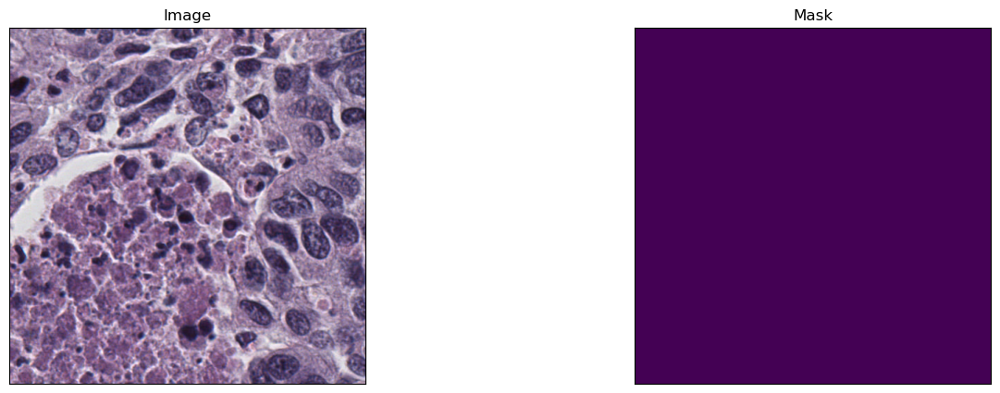

In [166]:
print("Length of dataset: ", len(dataset))
r = randint(0, len(dataset) - 1)
image, masks = dataset[r]

print("Mask unique: ", np.unique(masks))
print("Mask shape: ", masks.shape)
visualize(
	image=image,
	mask=masks
)


unique, counts = np.unique(masks, return_counts=True)

# Define the model

In [7]:
class model():
	def __init__(self, arch, backbone, encoder, lr, activation):
		self.arch = arch
		self.backbone = backbone

		# callbacks
		self.checkpoint = tf.keras.callbacks.ModelCheckpoint(
			f'./models/{arch}/{backbone}/best_model.keras',
			monitor='iou_score',
			verbose=1,
			save_best_only=True,
			save_weights_only=False,
			mode='max',
			save_freq='epoch',
			initial_value_threshold=None
		)
		name = arch + "-" + backbone
		self.tensorboard = tf.keras.callbacks.TensorBoard(log_dir=f"logs/{name}")
		
		# loss functions
		dice_loss = sm.losses.DiceLoss(class_weights=np.array([0, .2, .2, .2, .2, .2]), per_image=True) 
		focal_loss = sm.losses.CategoricalFocalLoss()
		jaccard_loss = sm.losses.JaccardLoss(per_image=True)
		total_loss = dice_loss + (1 * focal_loss) + jaccard_loss

		# metrices
		metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5)]
		self.preprocess = sm.get_preprocessing(backbone)

		opt = keras.optimizers.Adam(lr)

		if arch == "Unet":
			self.model = sm.Unet(backbone_name=backbone, encoder_weights=encoder, activation=activation, classes=6, input_shape=(SIZE, SIZE, 3))
			self.model.compile(opt, loss=total_loss, metrics=metrics)
		else:
			print("Unknown model arch. The model is undefined.")
	

	def summary(self):
		self.model.summary()


	def train(self):
		SET_SIZE = 256
		cnt = 1

		batch_size = 8

		epoch_size = 20
		initial_epoch = 0

		goal = len(dataset)
		for i in tqdm(range(0, goal, SET_SIZE)):
			x_train, y_train, x_val, y_val = dataset.export_split(dataset.images_path[i:i+SET_SIZE], dataset.masks_path[i:i+SET_SIZE], ratio=0.8, cat=True)

			pre_x_train = self.preprocess(x_train)
			pre_x_val = self.preprocess(x_val)

			history = self.model.fit(pre_x_train, y_train,
									validation_data=(pre_x_val, y_val),
									batch_size=batch_size,
									shuffle=True,
									verbose=1,
									initial_epoch=initial_epoch,
									epochs=initial_epoch + epoch_size,
									callbacks=[self.checkpoint, self.tensorboard]
								)

			self.model.save(f'./models/{self.arch}/{self.backbone}/latest_after_{initial_epoch + epoch_size}_epochs.keras')

			cnt += 1
			initial_epoch += epoch_size
	

In [8]:
model = model(arch="Unet", backbone="resnet34", encoder="imagenet", activation="softmax", lr=0.0001)

In [171]:
model.train()

  0%|          | 0/5 [00:00<?, ?it/s]

Input images and masks shape:  (256, 512, 512, 3) (256, 512, 512, 1)
Epoch 1/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - f1-score: 0.0455 - iou_score: 0.0372 - loss: 2.0362
Epoch 1: iou_score improved from -inf to 0.09038, saving model to ./models/Unet/resnet34/best_model.keras
26/26 ━━━━━━━━━━━━━━━━━━━━ 287s 10s/step - f1-score: 0.0478 - iou_score: 0.0391 - loss: 2.0354 - val_f1-score: 0.3245 - val_iou_score: 0.3179 - val_loss: 2.1125
Epoch 2/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 9s/step - f1-score: 0.2286 - iou_score: 0.1891 - loss: 1.9531 
Epoch 2: iou_score improved from 0.09038 to 0.20079, saving model to ./models/Unet/resnet34/best_model.keras
26/26 ━━━━━━━━━━━━━━━━━━━━ 264s 10s/step - f1-score: 0.2290 - iou_score: 0.1896 - loss: 1.9527 - val_f1-score: 0.4028 - val_iou_score: 0.3939 - val_loss: 2.0281
Epoch 3/20
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 10s/step - f1-score: 0.3336 - iou_score: 0.2870 - loss: 1.9034
Epoch 3: iou_score improved from 0.20079 to 0.33800, saving model to ./models/Unet/

 20%|██        | 1/5 [1:20:12<5:20:48, 4812.13s/it]

Input images and masks shape:  (256, 512, 512, 3) (256, 512, 512, 1)
Epoch 21/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.4628 - iou_score: 0.4399 - loss: 1.9798
Epoch 21: iou_score did not improve from 0.86729
26/26 ━━━━━━━━━━━━━━━━━━━━ 212s 8s/step - f1-score: 0.4633 - iou_score: 0.4404 - loss: 1.9782 - val_f1-score: 0.4525 - val_iou_score: 0.4232 - val_loss: 2.1180
Epoch 22/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.6190 - iou_score: 0.5847 - loss: 1.8144
Epoch 22: iou_score did not improve from 0.86729
26/26 ━━━━━━━━━━━━━━━━━━━━ 198s 8s/step - f1-score: 0.6190 - iou_score: 0.5848 - loss: 1.8139 - val_f1-score: 0.5944 - val_iou_score: 0.5554 - val_loss: 1.8314
Epoch 23/40
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.6441 - iou_score: 0.6256 - loss: 1.7344
Epoch 23: iou_score did not improve from 0.86729
26/26 ━━━━━━━━━━━━━━━━━━━━ 197s 8s/step - f1-score: 0.6439 - iou_score: 0.6251 - loss: 1.7351 - val_f1-score: 0.6171 - val_iou_score: 0.5788 - val_loss:

 40%|████      | 2/5 [2:28:35<3:39:45, 4395.28s/it]

Input images and masks shape:  (256, 512, 512, 3) (256, 512, 512, 1)
Epoch 41/60
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.8974 - iou_score: 0.8589 - loss: 1.8037
Epoch 41: iou_score did not improve from 0.93216
26/26 ━━━━━━━━━━━━━━━━━━━━ 209s 8s/step - f1-score: 0.8980 - iou_score: 0.8596 - loss: 1.8034 - val_f1-score: 0.9470 - val_iou_score: 0.9138 - val_loss: 1.8165
Epoch 42/60
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.9392 - iou_score: 0.9128 - loss: 1.7469
Epoch 42: iou_score did not improve from 0.93216
26/26 ━━━━━━━━━━━━━━━━━━━━ 197s 8s/step - f1-score: 0.9388 - iou_score: 0.9123 - loss: 1.7469 - val_f1-score: 0.9556 - val_iou_score: 0.9271 - val_loss: 1.7846
Epoch 43/60
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.9404 - iou_score: 0.9216 - loss: 1.7166
Epoch 43: iou_score did not improve from 0.93216
26/26 ━━━━━━━━━━━━━━━━━━━━ 196s 8s/step - f1-score: 0.9403 - iou_score: 0.9215 - loss: 1.7167 - val_f1-score: 0.9620 - val_iou_score: 0.9354 - val_loss:

 60%|██████    | 3/5 [3:38:10<2:23:09, 4294.52s/it]

Input images and masks shape:  (256, 512, 512, 3) (256, 512, 512, 1)
Epoch 61/80
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.6804 - iou_score: 0.6465 - loss: 1.8892
Epoch 61: iou_score did not improve from 0.99602
26/26 ━━━━━━━━━━━━━━━━━━━━ 206s 8s/step - f1-score: 0.6815 - iou_score: 0.6477 - loss: 1.8876 - val_f1-score: 0.7209 - val_iou_score: 0.6744 - val_loss: 1.8850
Epoch 62/80
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.7315 - iou_score: 0.6940 - loss: 1.8024
Epoch 62: iou_score did not improve from 0.99602
26/26 ━━━━━━━━━━━━━━━━━━━━ 205s 8s/step - f1-score: 0.7312 - iou_score: 0.6935 - loss: 1.8026 - val_f1-score: 0.8273 - val_iou_score: 0.7833 - val_loss: 1.8528
Epoch 63/80
26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.7870 - iou_score: 0.7373 - loss: 1.7820
Epoch 63: iou_score did not improve from 0.99602
26/26 ━━━━━━━━━━━━━━━━━━━━ 197s 8s/step - f1-score: 0.7879 - iou_score: 0.7382 - loss: 1.7816 - val_f1-score: 0.9035 - val_iou_score: 0.8608 - val_loss:

 80%|████████  | 4/5 [4:44:39<1:09:33, 4173.96s/it]

Input images and masks shape:  (229, 512, 512, 3) (229, 512, 512, 1)
Epoch 81/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.6322 - iou_score: 0.5786 - loss: 1.8269
Epoch 81: iou_score did not improve from 0.99602
23/23 ━━━━━━━━━━━━━━━━━━━━ 179s 8s/step - f1-score: 0.6329 - iou_score: 0.5794 - loss: 1.8271 - val_f1-score: 0.4637 - val_iou_score: 0.4109 - val_loss: 2.1831
Epoch 82/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.7614 - iou_score: 0.7214 - loss: 1.7689
Epoch 82: iou_score did not improve from 0.99602
23/23 ━━━━━━━━━━━━━━━━━━━━ 174s 8s/step - f1-score: 0.7616 - iou_score: 0.7215 - loss: 1.7688 - val_f1-score: 0.6619 - val_iou_score: 0.6094 - val_loss: 2.1053
Epoch 83/100
23/23 ━━━━━━━━━━━━━━━━━━━━ 0s 7s/step - f1-score: 0.8364 - iou_score: 0.8016 - loss: 1.7158
Epoch 83: iou_score did not improve from 0.99602
23/23 ━━━━━━━━━━━━━━━━━━━━ 174s 8s/step - f1-score: 0.8356 - iou_score: 0.8008 - loss: 1.7158 - val_f1-score: 0.7753 - val_iou_score: 0.7249 - val_lo

100%|██████████| 5/5 [5:43:23<00:00, 4120.63s/it]  


In [9]:
from keras.models import load_model
loaded_model = load_model('./models/Unet/resnet34/best_model.keras', compile=False)

In [10]:
x_test, y_test, x_empty, y_empty = dataset.export_split(dataset.images_test_path, dataset.masks_test_path, 1, cat=False)
x_test = model.preprocess(x_test)
y_pred = loaded_model.predict(x_test)
y_pred_argmax = np.argmax(y_pred, axis=3)
print(y_pred_argmax.shape, np.unique(y_pred_argmax))

Input images and masks shape:  (50, 512, 512, 3) (50, 512, 512, 1)
2/2 ━━━━━━━━━━━━━━━━━━━━ 11s 4s/step
(50, 512, 512) [0 1 2 4 5]


In [11]:
from keras.metrics import MeanIoU
IOU_keras = MeanIoU(num_classes=len(dataset.classes)+1)  
IOU_keras.update_state(y_test[:,:,:,0], y_pred_argmax)
print("Mean IoU =", IOU_keras.result().numpy())
		

Mean IoU = 0.18647593


In [12]:
def gray_to_rgb(x):
    x_reshaped = np.concatenate([x] * 3, axis=-1)
    color_map = {
            1: [255, 0, 0],   # Red for lepidic
            2: [0, 255, 0],   # Green for acinar
            3: [0, 0, 255],    # Blue for micropapillary
            4: [255, 255, 0],  # Yellow for papillary
            5: [255, 0, 255],   # violet for solid
        }
    
    rgb = np.zeros_like(x_reshaped, dtype=np.uint8)
    for label, color in color_map.items():
            rgb[x_reshaped[..., 0] == label] = color 
    return rgb

In [13]:
# Convert to colors according to classes
y_test_rgb = gray_to_rgb(y_test)
y_pred_argmax_expanded = np.expand_dims(y_pred_argmax, axis=-1)
y_pred_argmax_rgb = gray_to_rgb(y_pred_argmax_expanded)

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


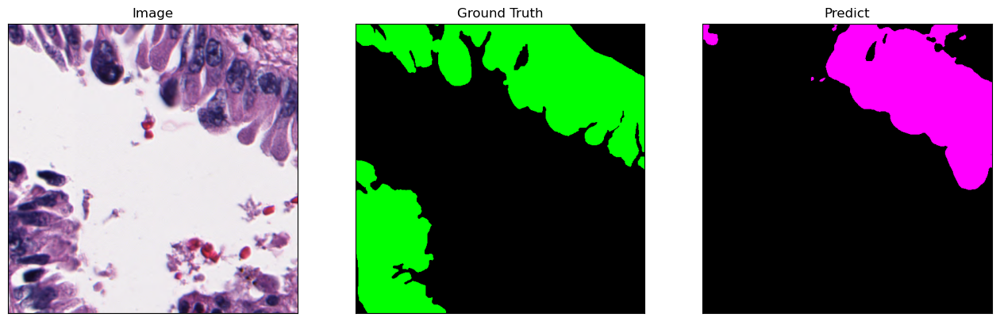

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


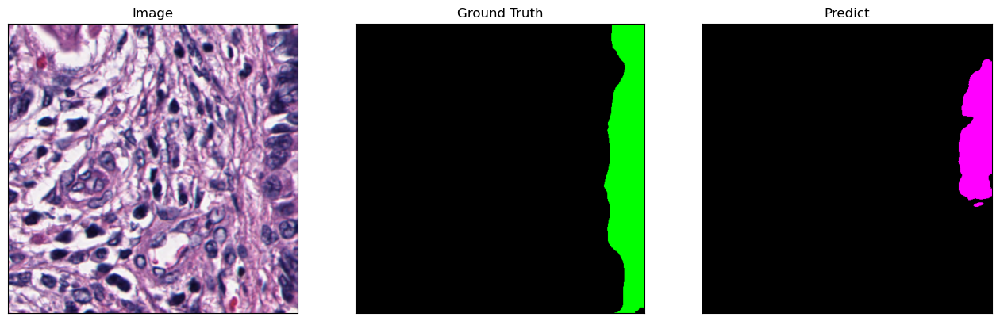

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


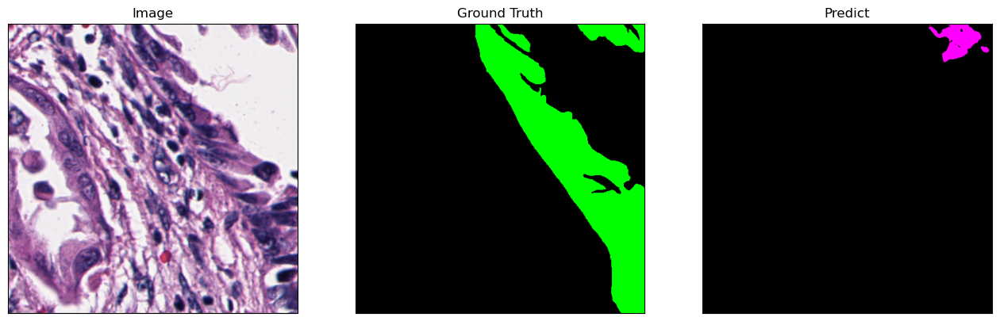

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 5]


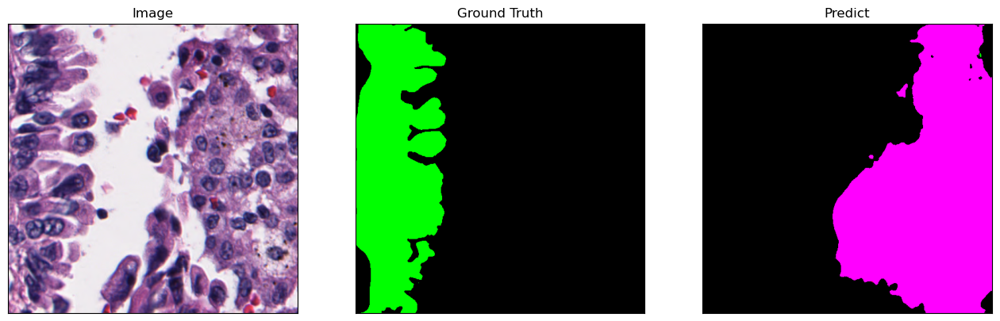

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 2 4 5]


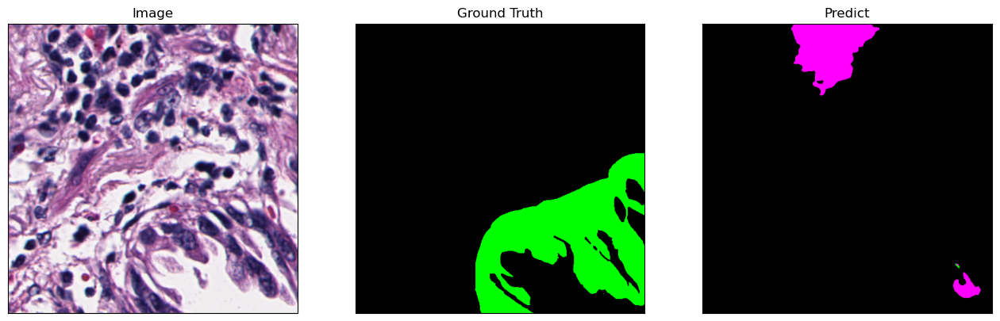

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 2 5]


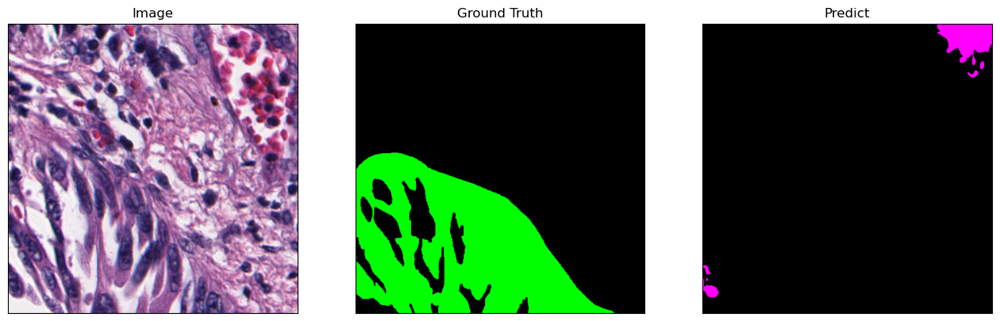

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


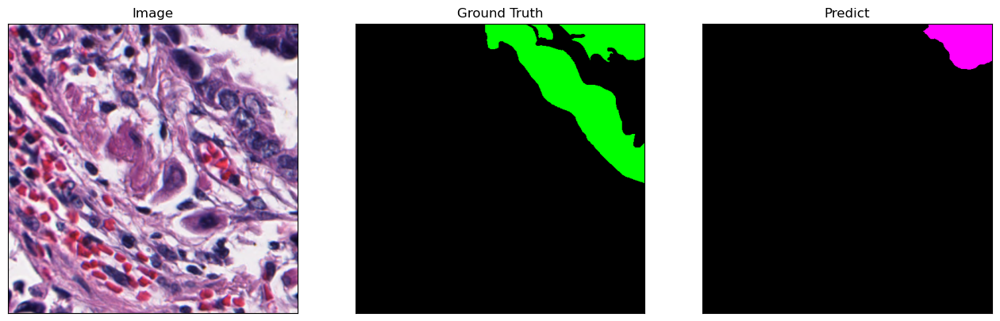

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0]


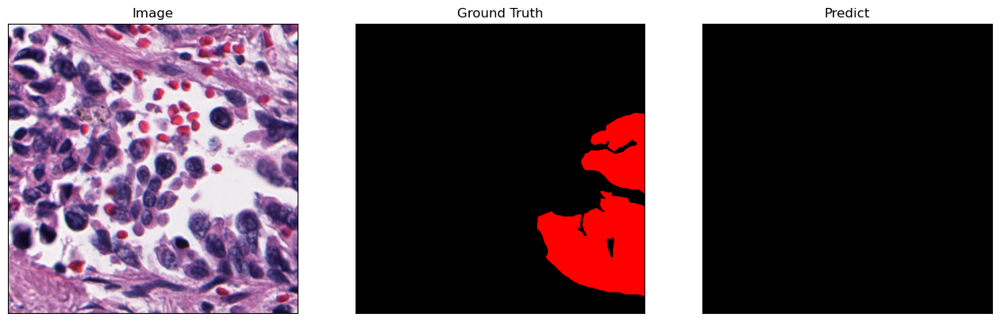

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 4 5]


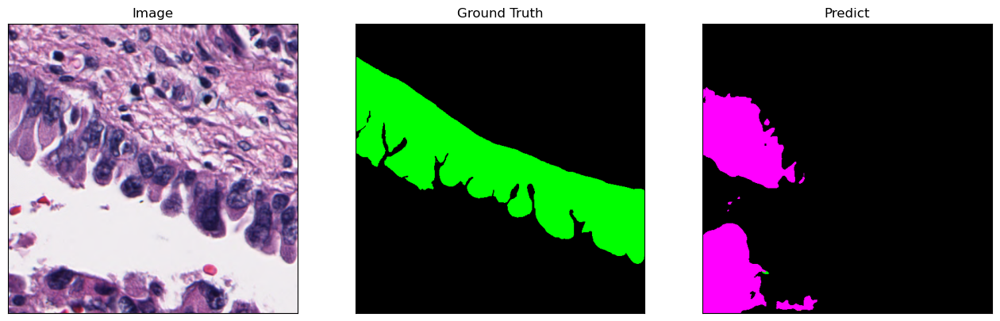

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


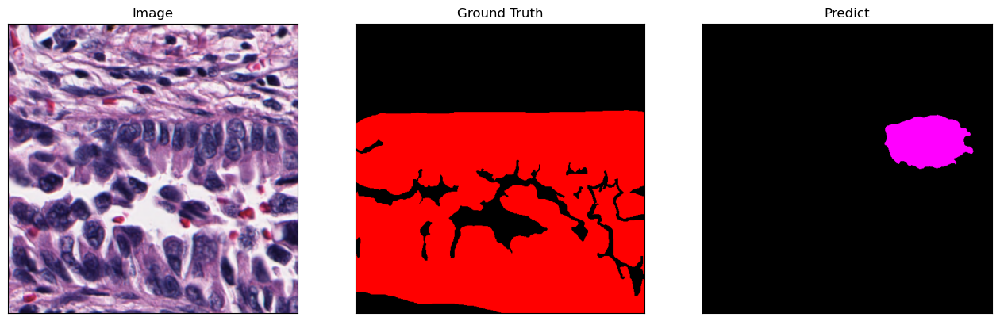

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0]


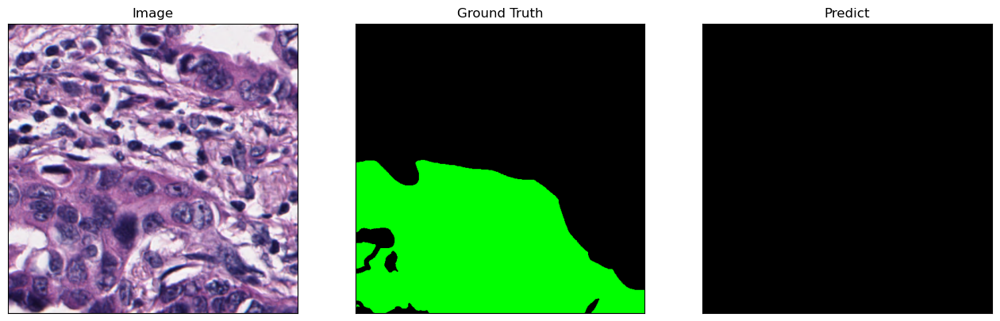

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 2 5]


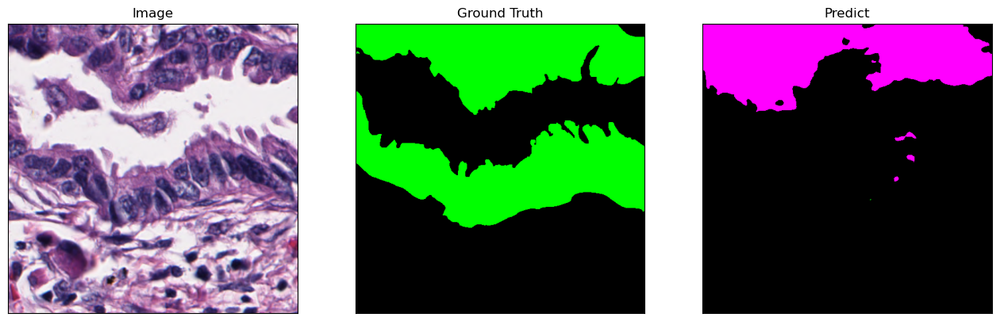

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0]


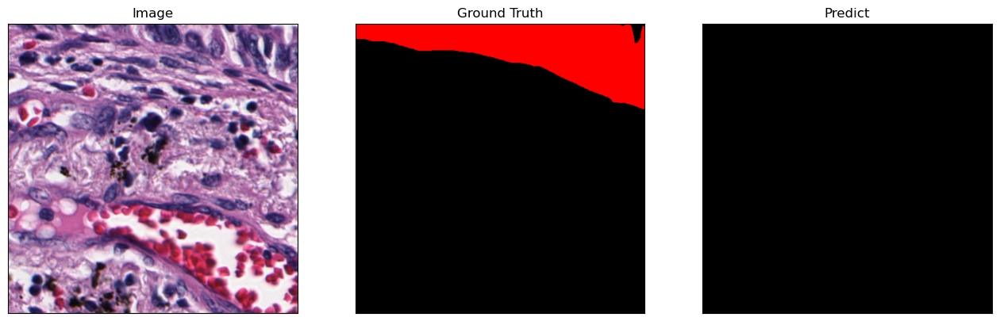

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 5]


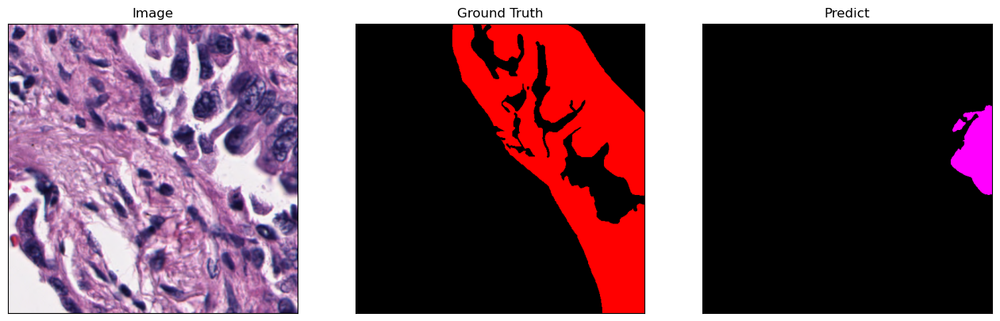

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 2 5]


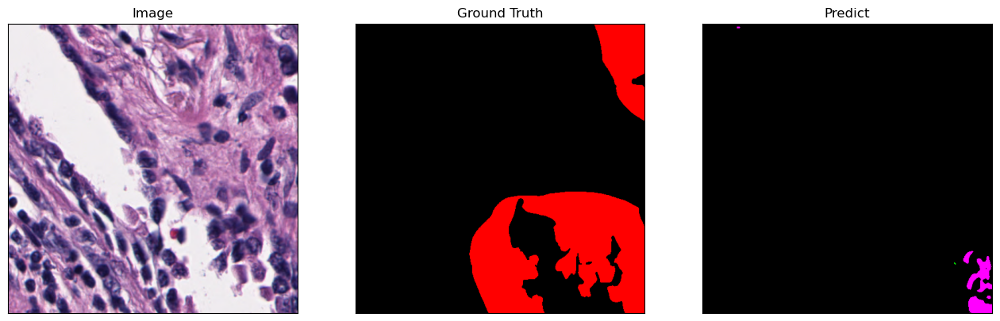

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 5]


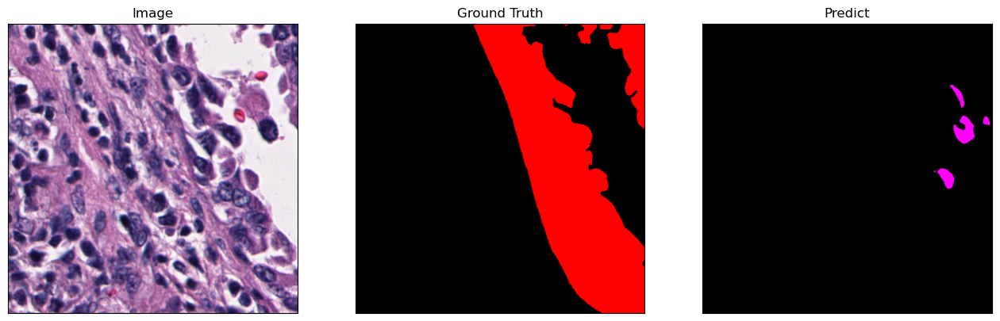

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 4 5]


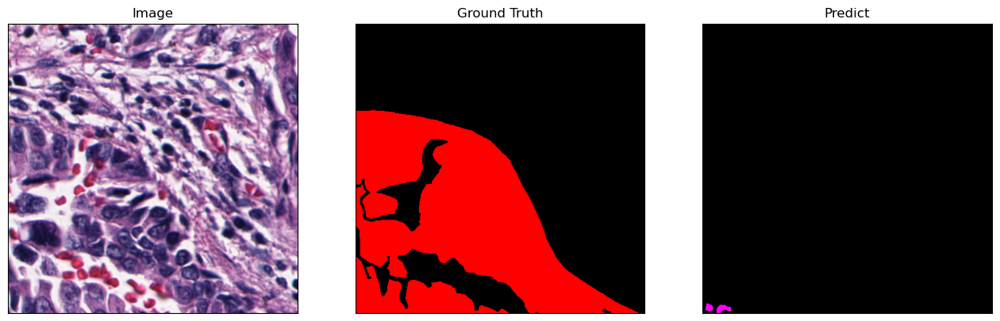

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


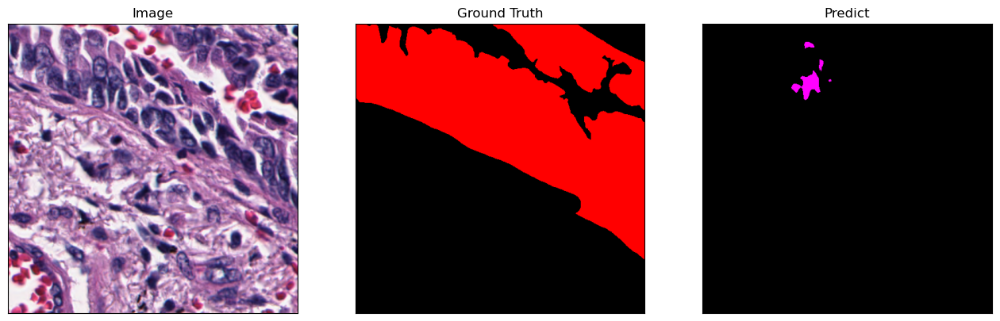

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 2 5]


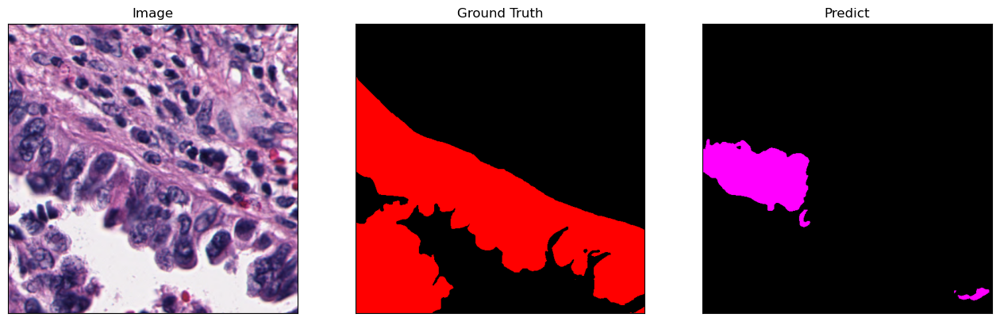

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 1]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 2 5]


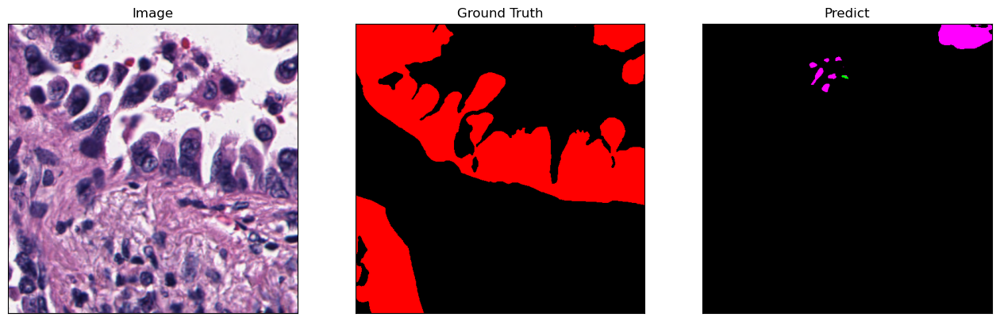

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 1 5]


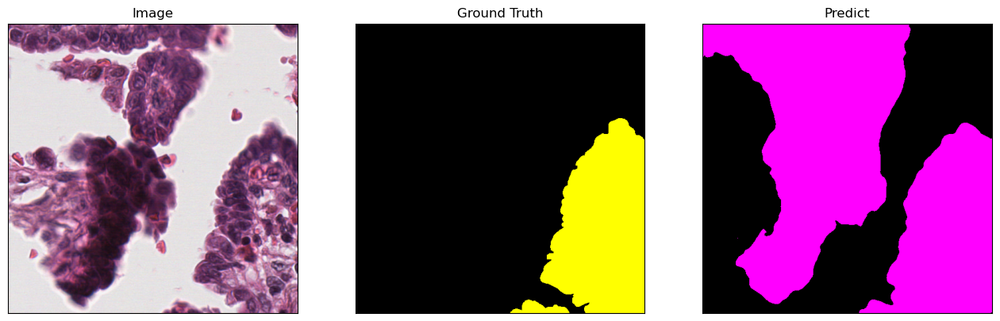

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


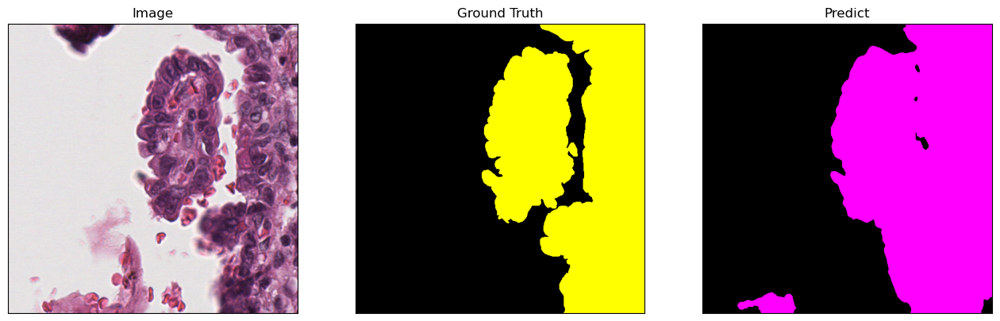

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


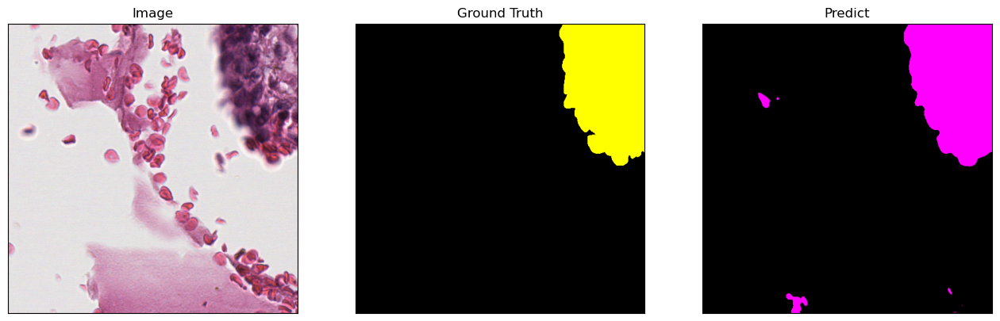

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


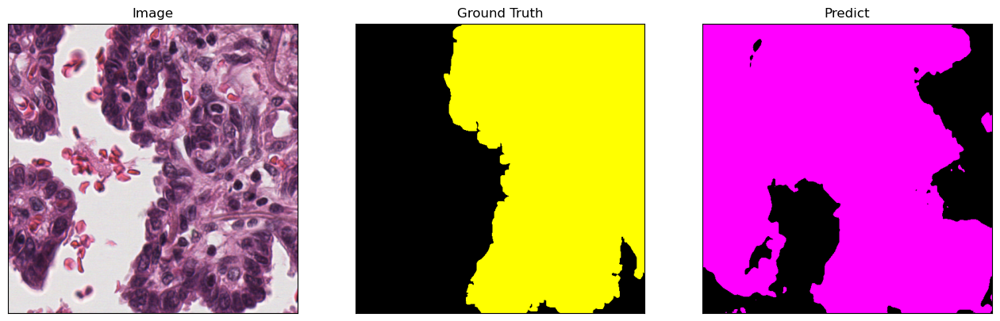

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


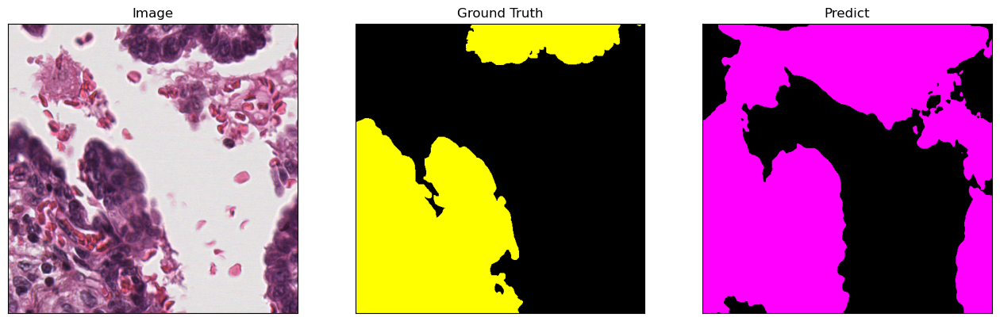

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


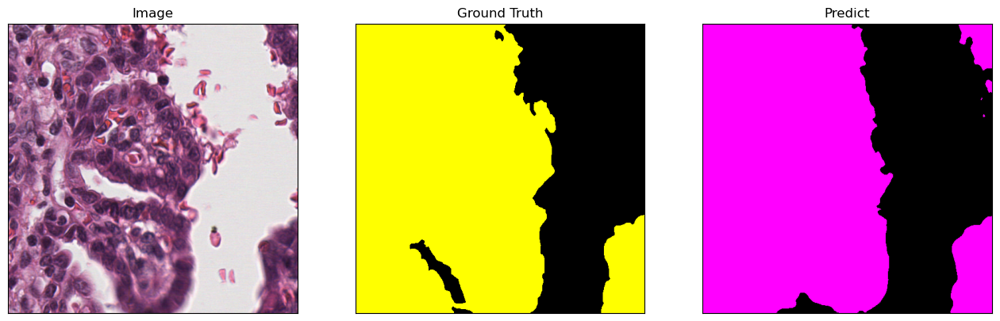

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


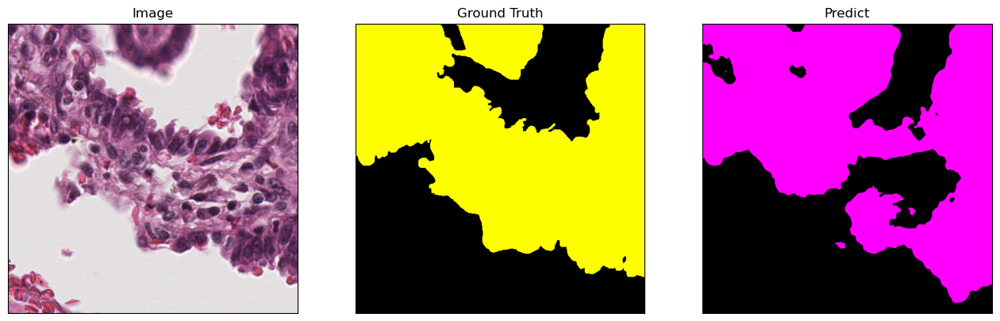

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


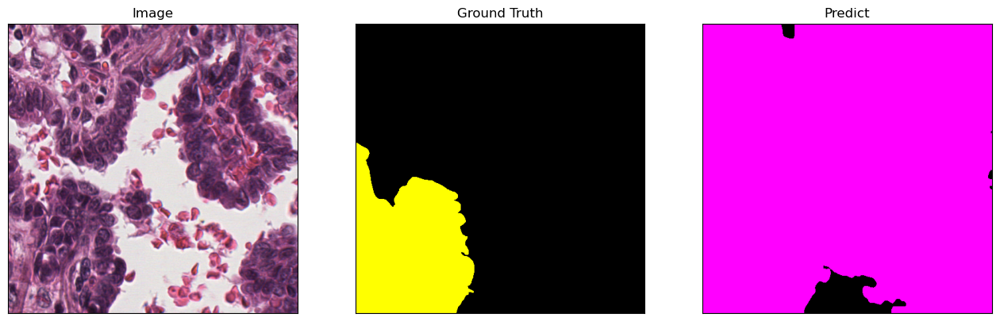

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


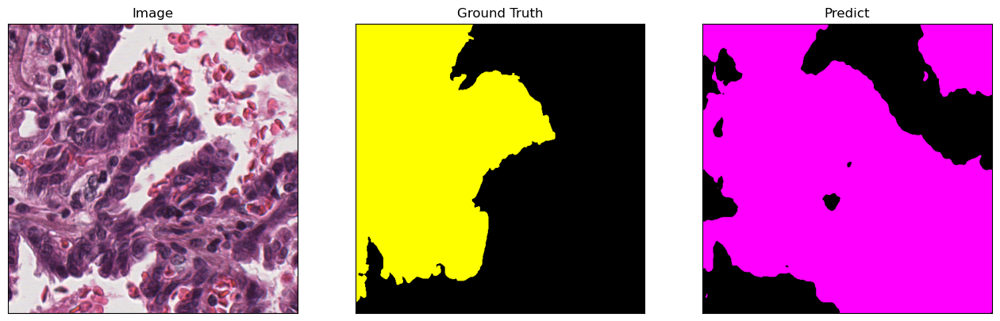

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 4]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


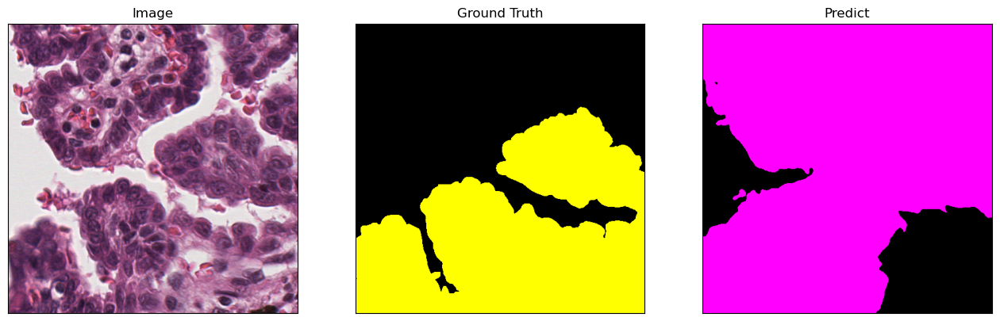

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


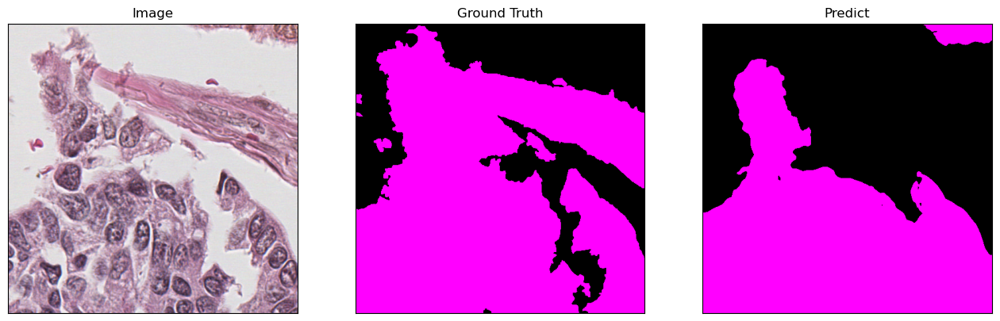

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


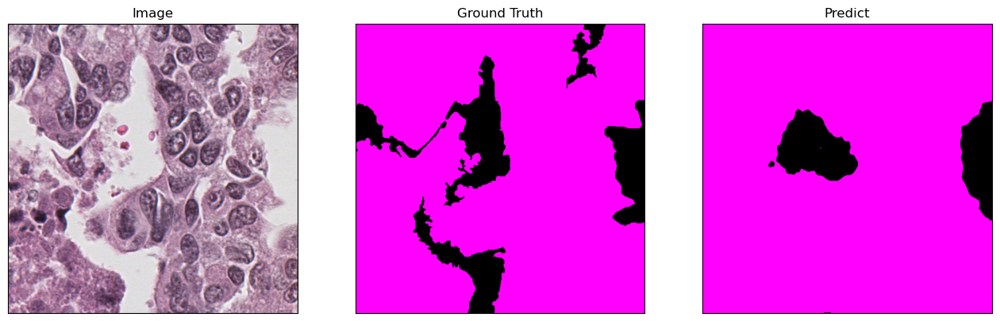

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


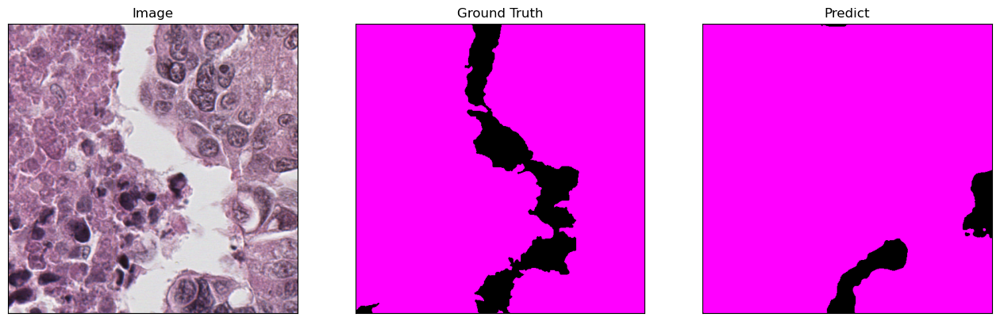

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


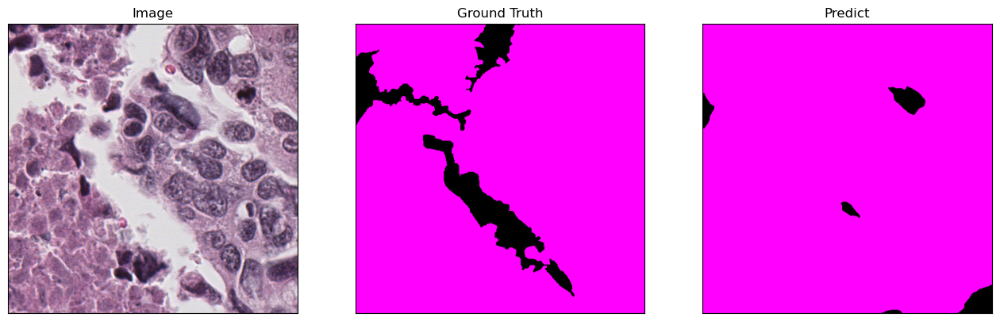

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


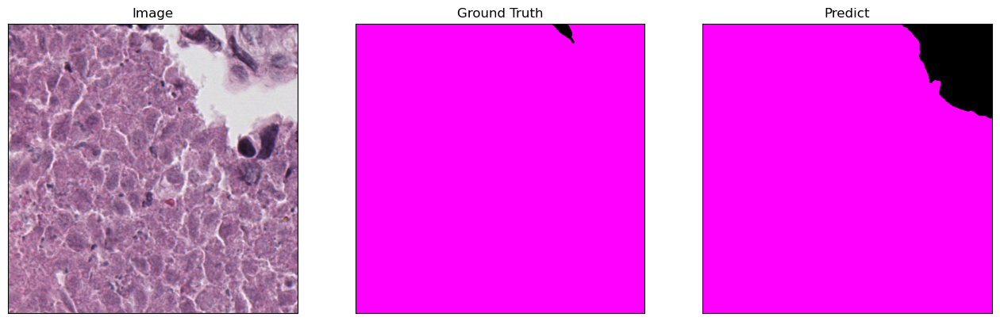

y_test shape:  (50, 512, 512, 1)
y_test unique:  [5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [5]


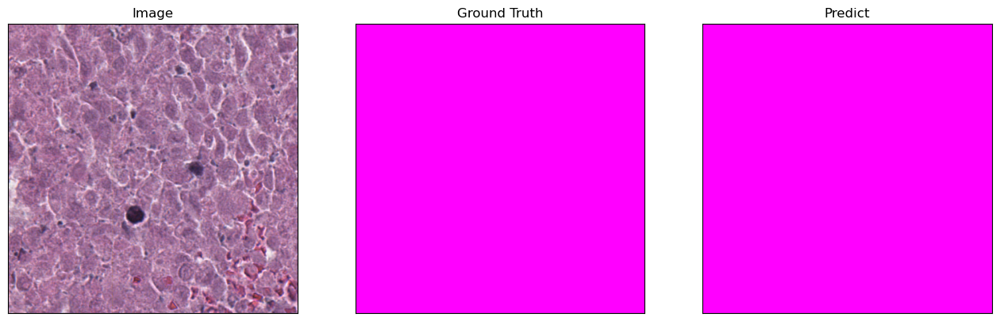

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


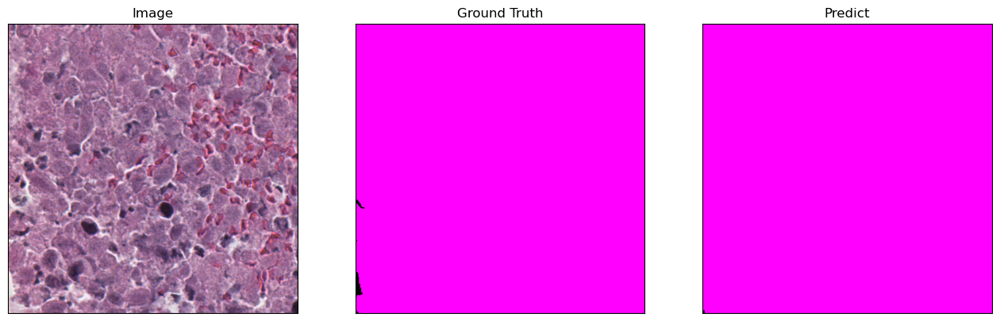

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


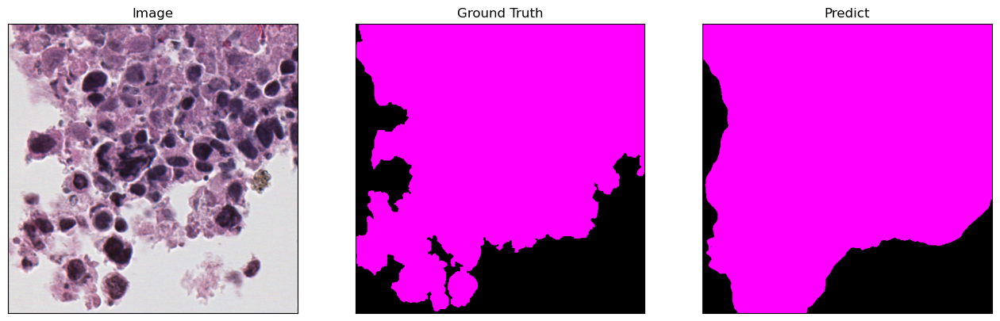

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


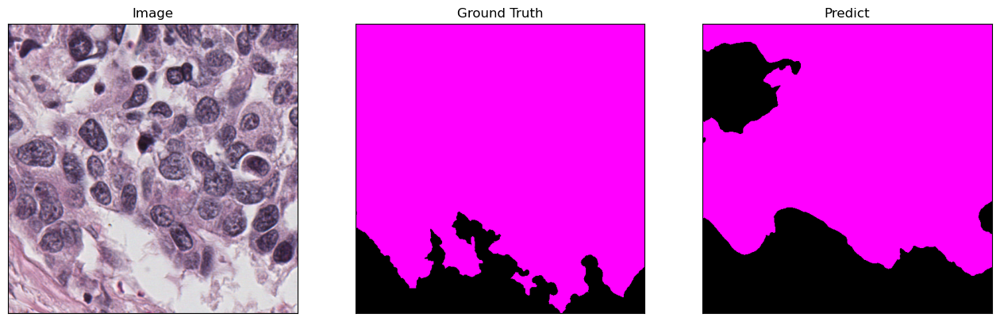

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 5]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


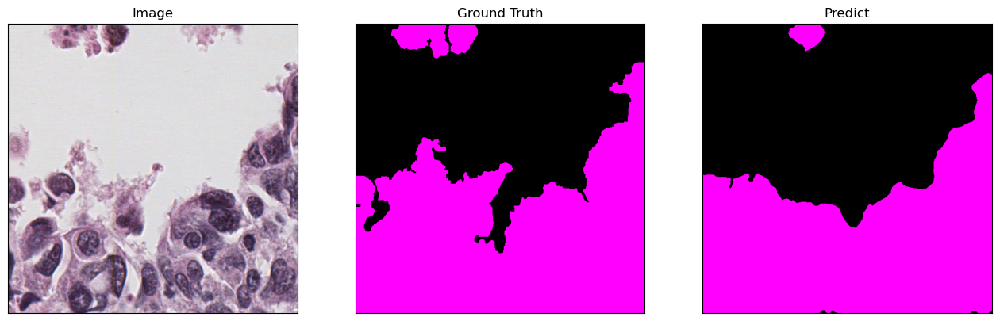

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


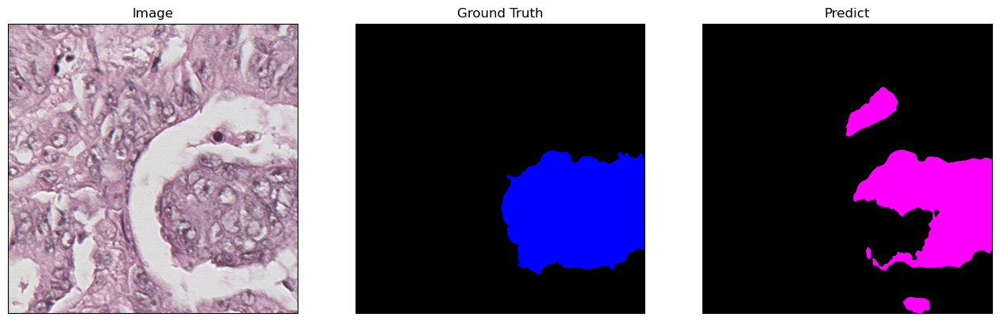

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


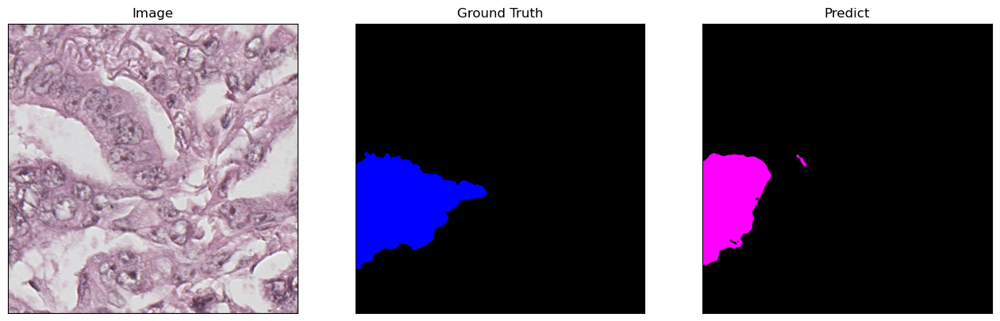

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


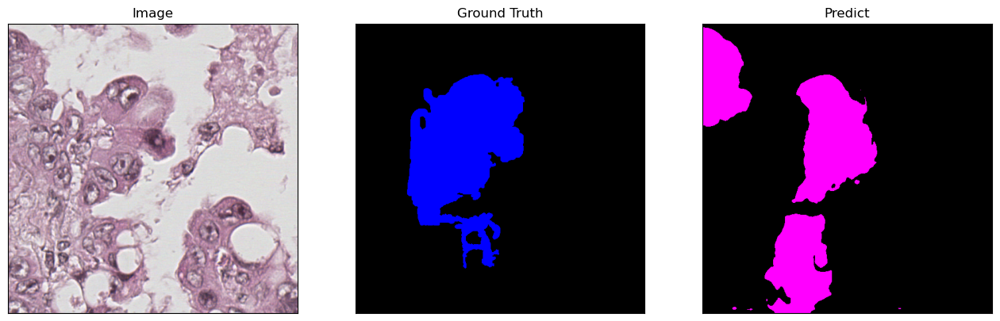

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


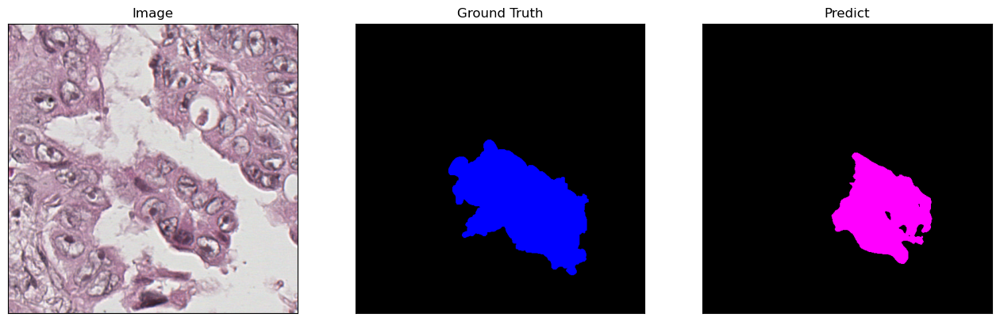

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


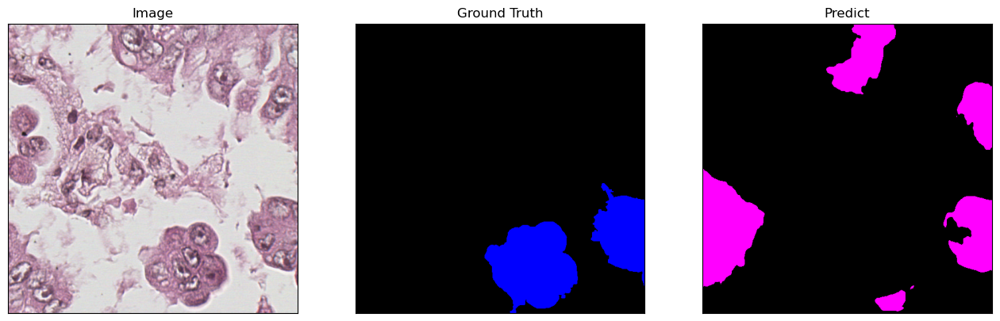

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


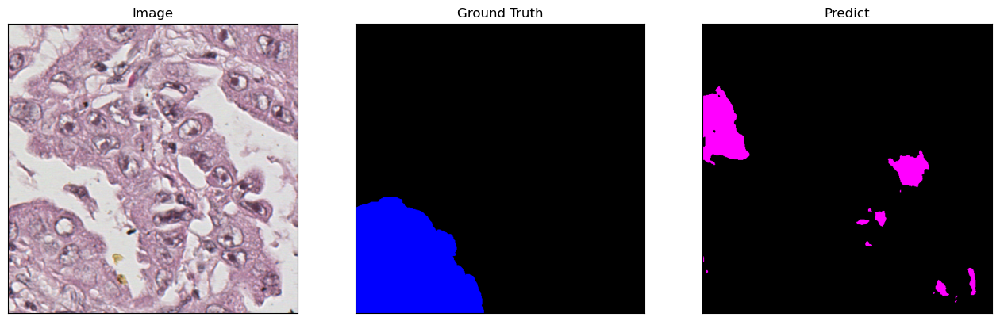

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


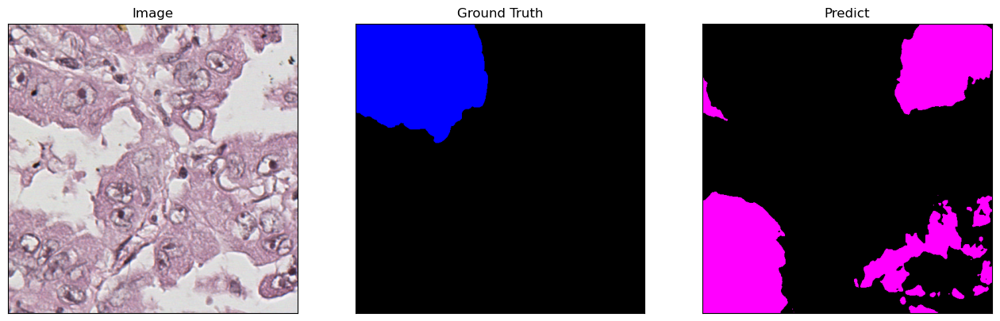

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 2 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


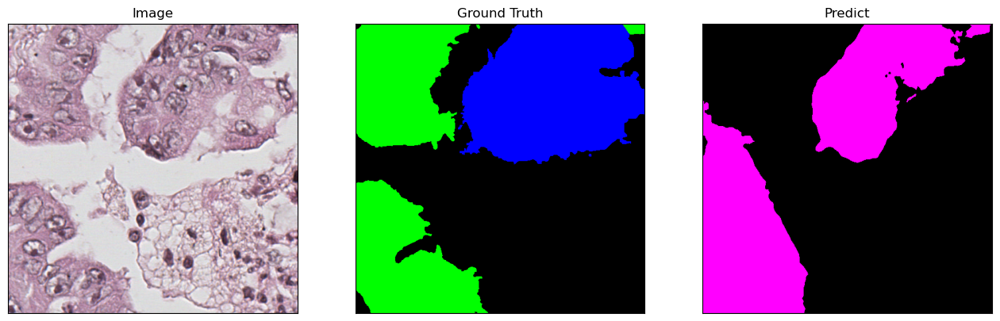

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


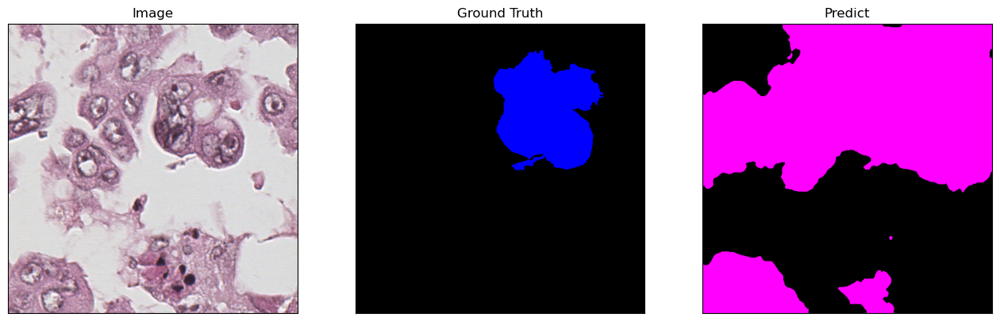

y_test shape:  (50, 512, 512, 1)
y_test unique:  [0 3]
y_pred_argmax_rgb shape:  (50, 512, 512, 3)
y_pred_argmax shape:  (50, 512, 512)
y_pred_argmax unique:  [0 5]


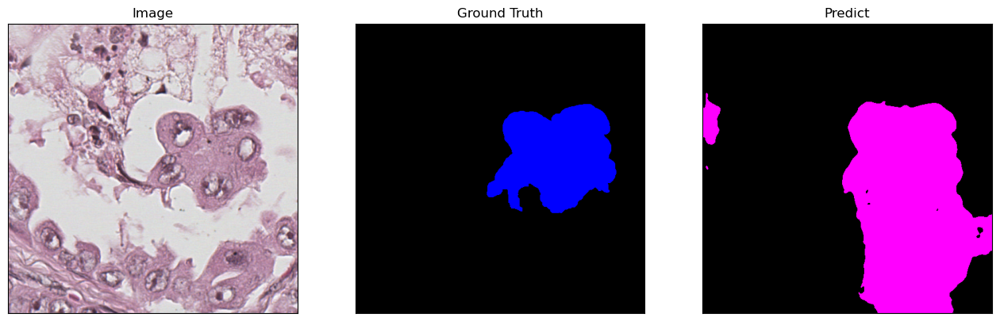

In [14]:

idx = randint(0, len(x_test)-1)
# idx = 16

for idx in range(len(x_test)):
	print("y_test shape: ", y_test.shape)
	print("y_test unique: ", np.unique(y_test[idx]))
	print("y_pred_argmax_rgb shape: ", y_pred_argmax_rgb.shape)
	print("y_pred_argmax shape: ", y_pred_argmax.shape)
	print("y_pred_argmax unique: ", np.unique(y_pred_argmax[idx]))
	visualize(
		image=x_test[idx],
		ground_truth=y_test_rgb[idx],
		predict=y_pred_argmax_rgb[idx],
	)

# array = np.full((50, 512, 512, 1), 2)
# array_rgb = gray_to_rgb(array)

# st = np.concatenate([array]*3,axis=-1)
# print(st.shape)
# # print(st)

# Red for lepidic
# Green for acinar
# Blue for micropapillary
# Yellow for papillary
# violet for solid